In [7]:
import sys
import torch
from pathlib import Path
import json
from PIL import Image
import requests
from transformers import AutoProcessor, AutoModelForVision2Seq
import torch
import matplotlib.pyplot as plt
import logging
import numpy as np
import os

# add src to path (jupyter notebook)
sys.path.append(os.path.join(Path(".").resolve(), '..'))
from src.dataloader import get_dataloader
from src.frame_select import FrameSelector, get_frame_selector
from src.vision import VisionLanguageModel, get_vision_model


In [8]:
notebook_config = {
    "frame_sampling": {'type': 'endpoint-interpolation', 'num_frames': 4},
    "model_configs": {'model_type': 'openai'},
    "api_keys": {
        "openai_key_path": "/home/akhassan/.openai_key"
    },
    "data_loader": {
        "success_ratio": 0.5,
        "num_samples": 10,
    },
    "paths": {
        "models": {
            "base_dir": "/home/akhassan/manipulation_uncertainty/models/",
            "checkpoints": "/home/akhassan/manipulation_uncertainty/models/checkpoints/",
            "pretrained": "/home/akhassan/manipulation_uncertainty/models/pretrained/"
        },
        "data": {
            "base_dir": "/scratch/akhassan/datasets/bc-z-robot/",
            "successes": ["/scratch/akhassan/datasets/bc-z-robot/bcz-21task_v9.0.1.tfrecord/bcz-21task_v9.0.1.tfrecord", "/scratch/akhassan/datasets/bc-z-robot/bcz-79task_v16.0.0.tfrecord/bcz-79task_v16.0.0.tfrecord"],
            "failures": ["/scratch/akhassan/datasets/bc-z-robot/bcz-21task_v9.0.1_failures.tfrecord/bcz-21task_v9.0.1_failures.tfrecord", "/scratch/akhassan/datasets/bc-z-robot/bcz-79task_v16.0.0_failures.tfrecord/bcz-79task_v16.0.0_failures.tfrecord"]
        },
        "logs": {
            "base_dir": "/home/akhassan/manipulation_uncertainty/logs/",
            "training": "/home/akhassan/manipulation_uncertainty/logs/training/",
            "evaluation": "/home/akhassan/manipulation_uncertainty/logs/evaluation/"
        }
    },
}

In [9]:
def visualize_trajectory(batch):
    # Take the first trajectory from the batch
    trajectory_frames = batch['frames'][0]  # This is a list of tensors
    subtask = batch['subtask_name'][0]
    label = batch['label'][0]
    num_frames = batch['num_frames'][0].item()  # Convert tensor to integer
    
    # Log information about the trajectory
    print(f"\nTrajectory Information:")
    print(f"Subtask: {subtask}")
    print(f"Success: {bool(label)}")
    print(f"Number of frames: {num_frames}")
    print(f"First frame shape: {trajectory_frames[0].shape}")
    
    # Create a grid of frames
    num_cols = 4
    num_rows = (num_frames + num_cols - 1) // num_cols
    
    plt.figure(figsize=(15, 3*num_rows))
    for i in range(num_frames):
        plt.subplot(num_rows, num_cols, i + 1)
        # Convert from [C, H, W] to [H, W, C]
        frame = trajectory_frames[i].permute(1, 2, 0).numpy()
        plt.imshow(frame)
        plt.title(f"Frame {i}")
        plt.axis('off')
    
    plt.suptitle(f"Trajectory for task: {subtask}\nSuccess: {bool(label)}")
    plt.tight_layout()
    plt.show()

In [10]:
frame_selector = get_frame_selector(notebook_config)

def select_frames(batch):
    frames = batch['frames'][0]
    # print(len(frames))
    subtask = batch['subtask_name'][0]

    selected_frames = frame_selector.select_frames(frames, subtask)
    # print(selected_frames.shape)

    # visualize output image (one tall image that contains all the selected frames)
    plt.imshow(selected_frames.permute(1, 2, 0).numpy())
    plt.axis('off')
    plt.show()

    return selected_frames


In [11]:
vlm = get_vision_model(notebook_config)

def assess_frames(selection, batch):
    subtask = batch['subtask_name'][0]
    label = batch['label'][0]
    prediction = vlm.predict_success(selection, subtask)

    print(f"Subtask: {subtask}")
    print(f"GT Success: {bool(label)}")
    print(f"Prediction: {prediction}")

In [12]:
dataloader = get_dataloader(notebook_config, debug=True)
iterator = iter(dataloader)

I0000 00:00:1732035608.498669  149033 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 21764 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4090, pci bus id: 0000:01:00.0, compute capability: 8.9
I0000 00:00:1732035608.500390  149033 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 22166 MB memory:  -> device: 1, name: NVIDIA GeForce RTX 4090, pci bus id: 0000:4b:00.0, compute capability: 8.9
2024-11-19 12:00:08.842995: I tensorflow/core/kernels/data/tf_record_dataset_op.cc:370] TFRecordDataset `buffer_size` is unspecified, default to 262144
2024-11-19 12:00:09.474220: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2024-11-19 12:00:09.605019: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Dataset length: 10



Trajectory Information:
Subtask: place the eraser on the white sponge
Success: False
Number of frames: 50
First frame shape: torch.Size([3, 512, 640])


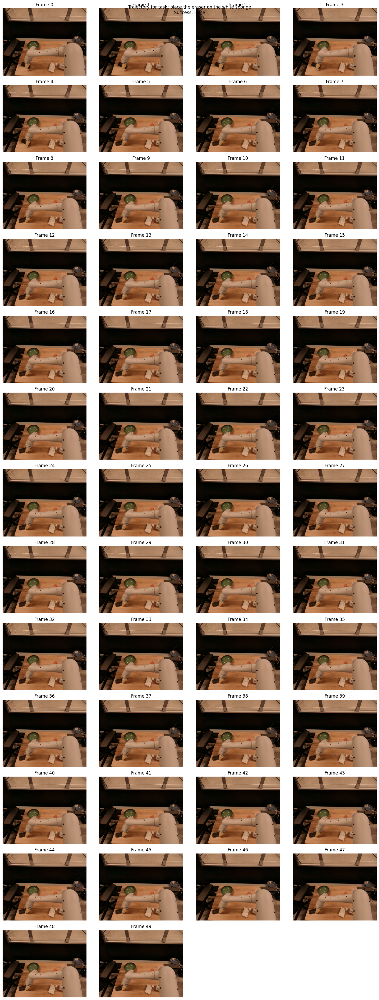

Selected Frames:


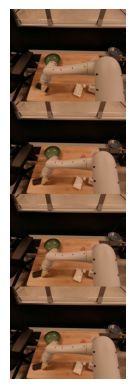

Subtask: place the eraser on the white sponge
GT Success: False
Prediction: {'success': False, 'confidence': 'high', 'explanation': 'The robot arm does not appear to have successfully placed the eraser on the white sponge. The positioning of the eraser suggests it is still in the gripper or placed on a different surface. Therefore, based on the visual cues, the task was not completed as specified.', 'valid': True}

Trajectory Information:
Subtask: knock the eraser over
Success: True
Number of frames: 14
First frame shape: torch.Size([3, 512, 640])


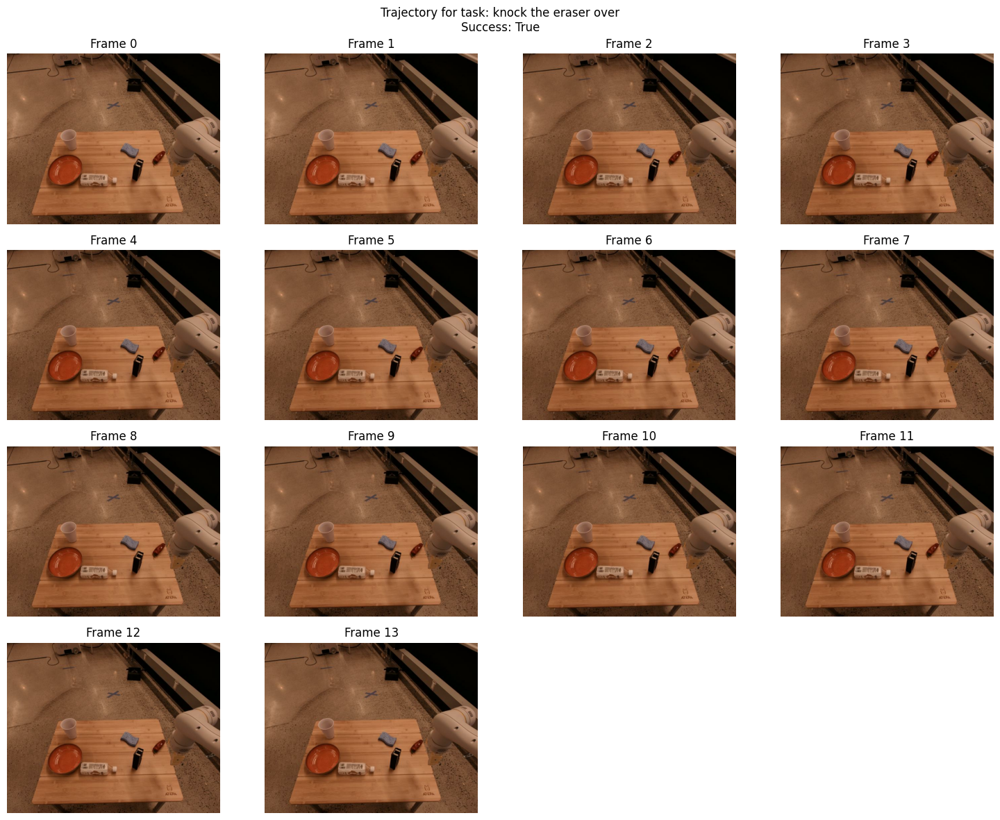

Selected Frames:


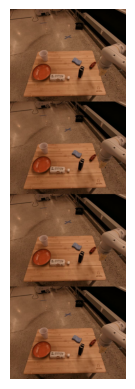

Subtask: knock the eraser over
GT Success: True
Prediction: {'success': False, 'confidence': 'high', 'explanation': 'The robot arm did not seem to successfully knock over the eraser as it appears to be intact and not moved from its original position. The assessment is based on a clear view of the workspace where the eraser is located.', 'valid': True}

Trajectory Information:
Subtask: stand the bottle upright
Success: False
Number of frames: 33
First frame shape: torch.Size([3, 512, 640])


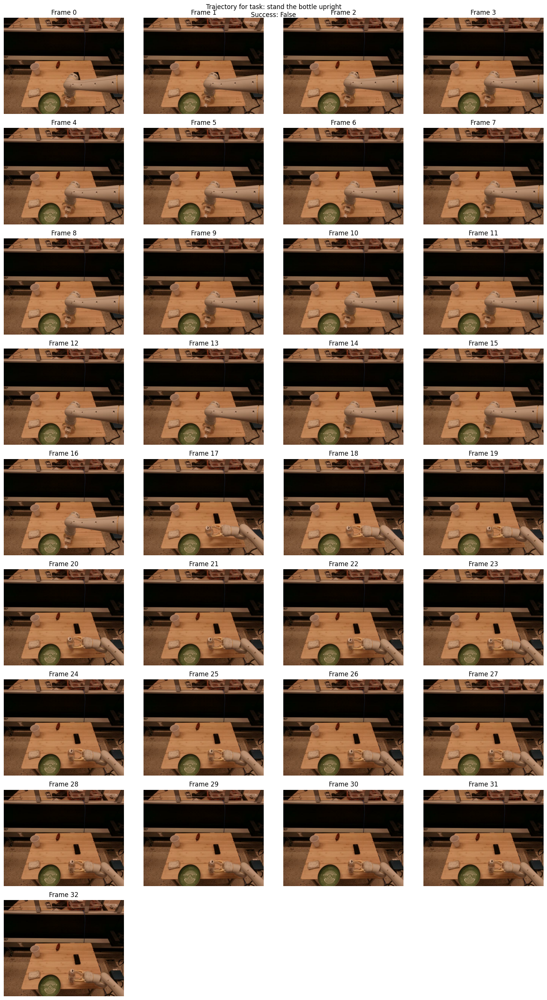

Selected Frames:


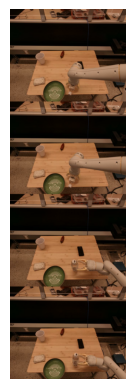

Subtask: stand the bottle upright
GT Success: False
Prediction: {'success': False, 'confidence': 'medium', 'explanation': 'The task to stand the bottle upright is likely not achieved, as the image shows the bottle in a tilted position. While there may be some attempt to maneuver the bottle, the overall orientation suggests it remains not upright. However, without more context or additional angles, confidence in this assessment is limited.', 'valid': True}

Trajectory Information:
Subtask: place the white sponge in the ceramic cup
Success: False
Number of frames: 34
First frame shape: torch.Size([3, 512, 640])


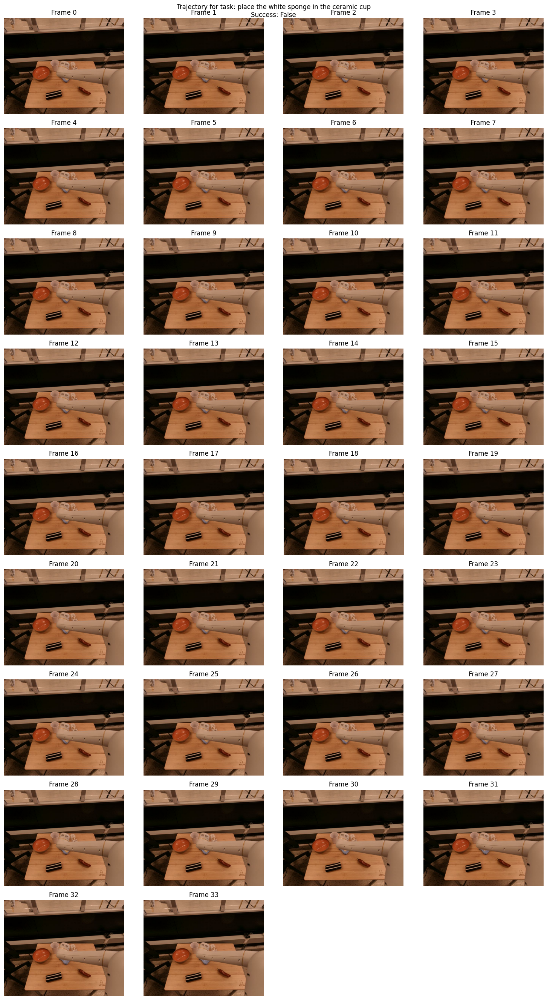

Selected Frames:


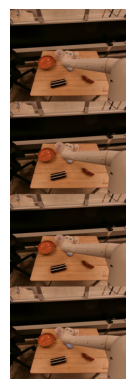

Subtask: place the white sponge in the ceramic cup
GT Success: False
Prediction: {'success': False, 'confidence': 'very low', 'explanation': "The image quality is unclear and does not provide adequate visibility of the robot arm's actions or the placement of the sponge in the ceramic cup. Without clear evidence of the task being completed, determining success is not feasible.", 'valid': True}

Trajectory Information:
Subtask: place the eraser on the white sponge
Success: False
Number of frames: 50
First frame shape: torch.Size([3, 512, 640])


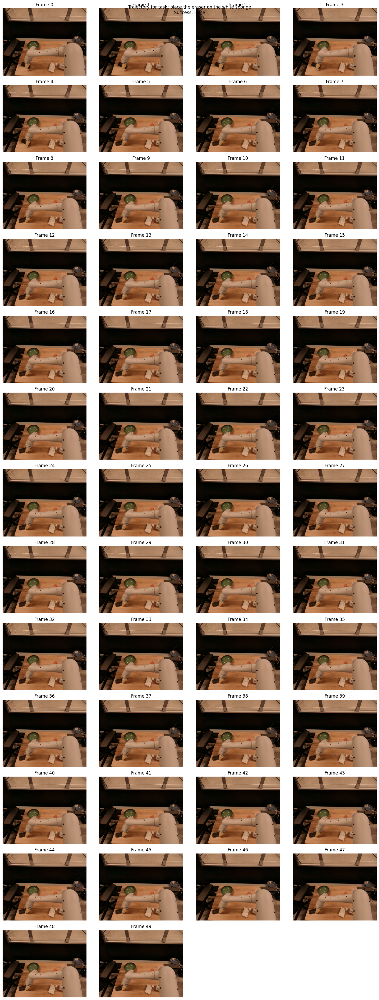

Selected Frames:


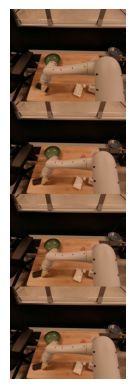

Subtask: place the eraser on the white sponge
GT Success: False
Prediction: {'success': False, 'confidence': 'medium', 'explanation': 'The eraser is not clearly visible on the white sponge in the provided images. While the robot arm is making an effort to place the eraser, the final position cannot be confirmed due to the lack of clear visibility. Therefore, I cannot definitively assess if the task was completed successfully.', 'valid': True}

Trajectory Information:
Subtask: place the white sponge in the ceramic cup
Success: True
Number of frames: 27
First frame shape: torch.Size([3, 512, 640])


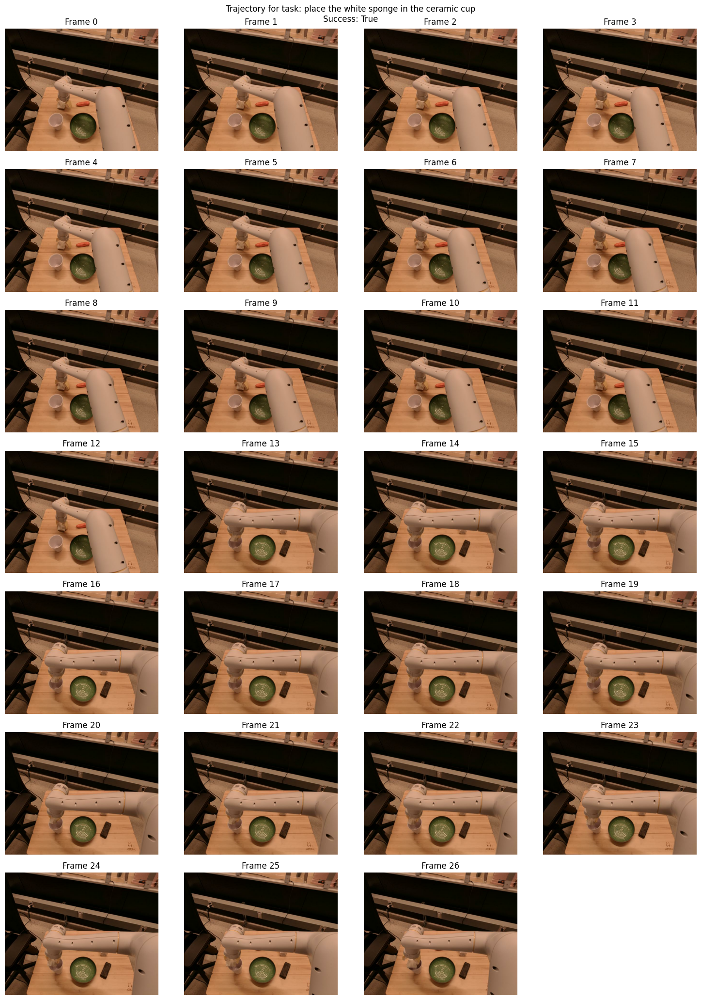

Selected Frames:


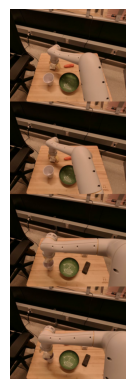

Subtask: place the white sponge in the ceramic cup
GT Success: True
Prediction: {'success': False, 'confidence': 'very low', 'explanation': 'The image is distorted and does not provide clear visual information about the position of the white sponge or the ceramic cup. Without a clear view, I cannot determine if the task of placing the sponge in the cup was completed successfully.', 'valid': True}

Trajectory Information:
Subtask: pick up the ceramic cup
Success: True
Number of frames: 21
First frame shape: torch.Size([3, 512, 640])


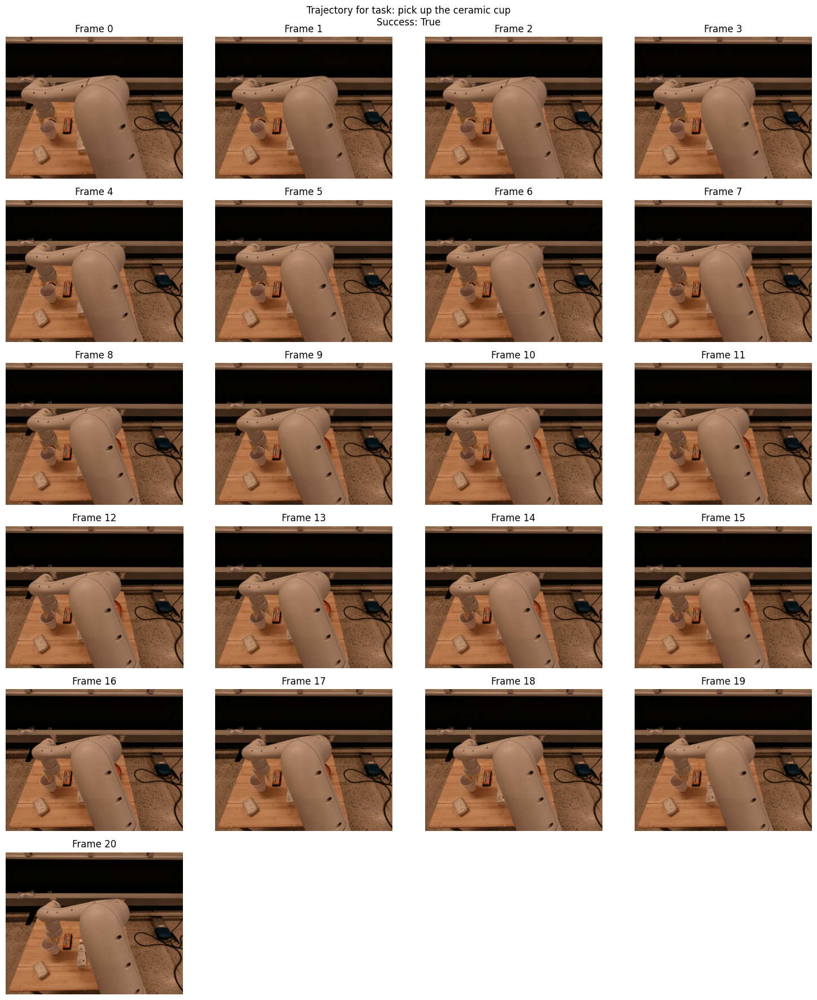

Selected Frames:


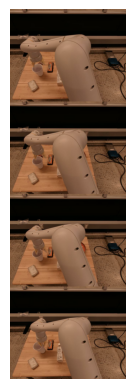

Subtask: pick up the ceramic cup
GT Success: True
Prediction: {'success': False, 'confidence': 'high', 'explanation': 'The robot arm is positioned near the ceramic cup but does not appear to be grasping it. There is no indication of contact or successful pickup, suggesting that the task was not completed.', 'valid': True}

Trajectory Information:
Subtask: place the ceramic cup in the ceramic bowl
Success: False
Number of frames: 27
First frame shape: torch.Size([3, 512, 640])


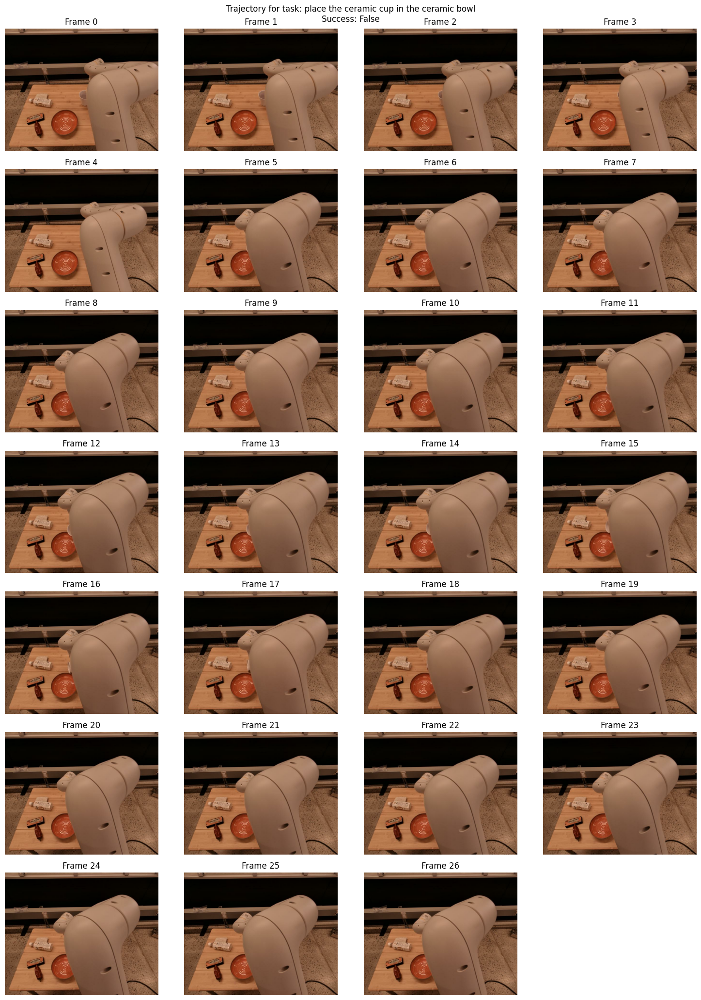

Selected Frames:


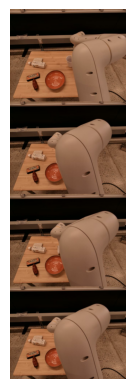

Subtask: place the ceramic cup in the ceramic bowl
GT Success: False
Prediction: {'success': False, 'confidence': 'medium', 'explanation': "The image shows the robot arm with the gripper positioned above the ceramic bowl, but it does not clearly indicate whether the ceramic cup has been successfully placed inside the bowl. Without a direct view of the cup's position relative to the bowl after the action, I can only infer that the task might not be completed.", 'valid': True}

Trajectory Information:
Subtask: place the ceramic cup over the eraser
Success: True
Number of frames: 32
First frame shape: torch.Size([3, 512, 640])


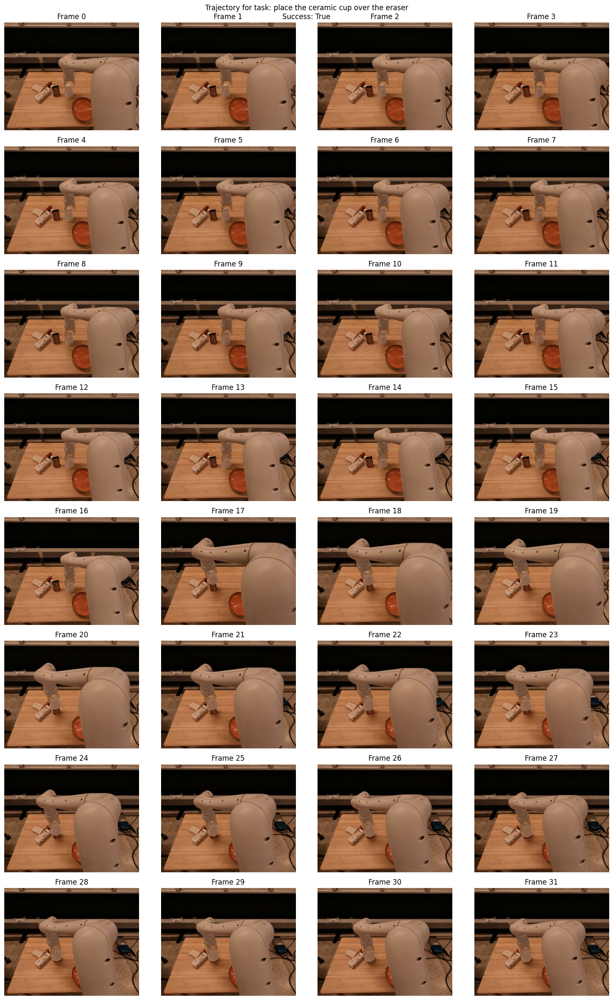

Selected Frames:


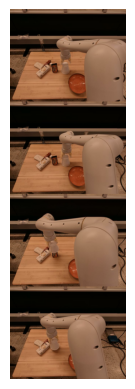

Subtask: place the ceramic cup over the eraser
GT Success: True
Prediction: {'success': False, 'confidence': 'medium', 'explanation': "The robot arm appears to be moving towards the eraser, but I cannot definitively see the final placement of the ceramic cup. Without clear evidence of the cup being placed directly over the eraser in the final position, I cannot confirm the task's completion.", 'valid': True}

Trajectory Information:
Subtask: knock the eraser over
Success: True
Number of frames: 32
First frame shape: torch.Size([3, 512, 640])


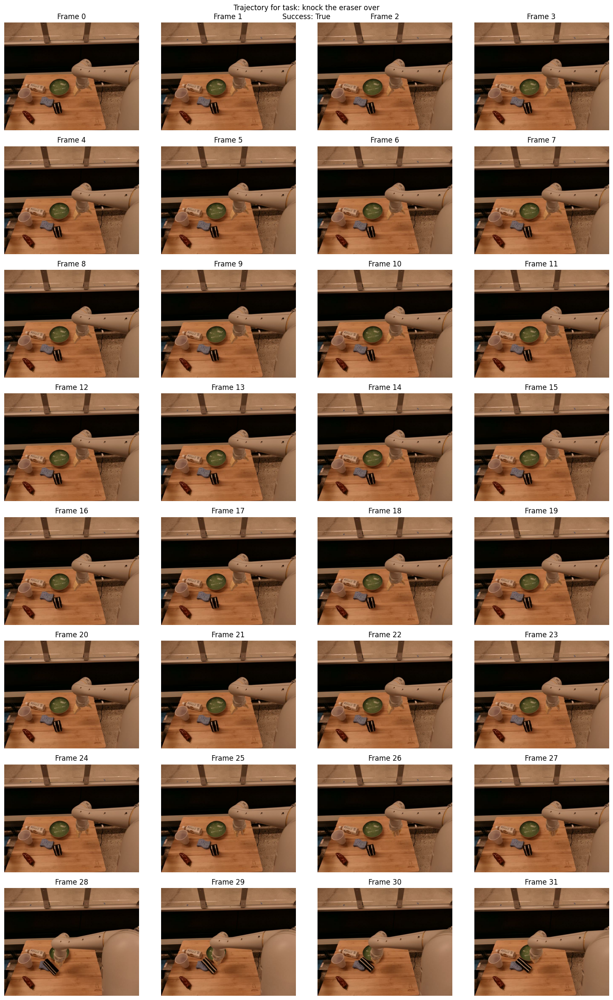

Selected Frames:


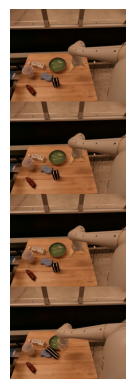

Subtask: knock the eraser over
GT Success: True
Prediction: {'success': False, 'confidence': 'high', 'explanation': 'The robot arm does not appear to have successfully knocked over the eraser, as it is still upright and in its original position. The assessment is made with high confidence based on the visible orientation and placement of the eraser.', 'valid': True}


In [14]:


for i in range(notebook_config['data_loader']['num_samples']):
    try:
        batch = next(iterator)
        visualize_trajectory(batch)
        print("Selected Frames:")
        selection = select_frames(batch)
        assess_frames(selection, batch)
    except Exception as e:
        logging.error(f"Error visualizing trajectory: {str(e)}", exc_info=True)